In [5]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from colour.io.luts.iridas_cube import read_LUT_IridasCube
import os

def read_lut(lut_path, clip=False):
    """
    Reads a LUT from the specified path, returning instance of LUT3D or LUT3x1D.
    
    Args:
    - lut_path (str): the path to the file from which to read the LUT.
    - clip (bool): flag indicating whether to apply clipping of LUT values.
    
    Returns:
    - lut: Instance of LUT3D or LUT3x1D.
    """
    lut = read_LUT_IridasCube(lut_path)
    lut.name = os.path.splitext(os.path.basename(lut_path))[0]

    if clip:
        if lut.domain[0].max() == lut.domain[0].min() and lut.domain[1].max() == lut.domain[1].min():
            lut.table = np.clip(lut.table, lut.domain[0, 0], lut.domain[1, 0])
        else:
            if len(lut.table.shape) == 2:  # 3x1D
                for dim in range(3):
                    lut.table[:, dim] = np.clip(lut.table[:, dim], lut.domain[0, dim], lut.domain[1, dim])
            else:  # 3D
                for dim in range(3):
                    lut.table[:, :, :, dim] = np.clip(lut.table[:, :, :, dim], lut.domain[0, dim], lut.domain[1, dim])

    return lut


def process_image(im, lut, log):
    """Applies LUT transformation to the image.
    
    Args:
    - im (PIL.Image): Input image.
    - lut: CubeLUT object containing LUT.
    - log (bool): If True, transform to log colorspace.
    
    Returns:
    - new_im (PIL.Image): Transformed image.
    """
    if im.mode != 'RGB':
        im = im.convert('RGB')
    im_array = np.asarray(im, dtype=np.float32) / 255
    if log:
        im_array = im_array ** (1/2.2)
    im_array = lut.apply(im_array)
    if log:
        im_array = im_array ** (2.2)
    im_array = im_array * 255
    new_im = Image.fromarray(np.uint8(im_array))
    return new_im


def plot_image_3d(image, subplot, dots=10_000):
    """Plots the 3D scatter plot of the image."""
    # Convert image into numpy array
    img_array = np.array(image) / 255
    r, g, b = img_array[:, :, 0].flatten(), img_array[:, :, 1].flatten(), img_array[:, :, 2].flatten()
    idxes = np.random.randint(0, len(r), dots)
    colors = img_array.reshape(-1, 3)

    # Plotting
    subplot.scatter(r[idxes], g[idxes], b[idxes], c=colors[idxes], alpha=0.5, s=1)


def plot_comparison(content_im, img_transferred_simple, img_transferred_cnf, style_im):
    """Plots the comparison between images and their 3D scatter plots."""
    fig = plt.figure(figsize=(30, 15))
    images = [content_im, img_transferred_simple, img_transferred_cnf, style_im]
    titles = ['Random uniform', 'Random uniform with LUT', 'Original Image', 'Original Image with LUT']

    for i in range(4):
        ax = fig.add_subplot(2, 4, i + 1)
        ax.imshow(images[i])
        ax.set_title(titles[i])
        ax.axis('off')

    for i in range(4):
        ax = fig.add_subplot(2, 4, i + 5, projection='3d')
        plot_image_3d(images[i], ax)
        ax.set_title(titles[i])
        ax.set_xlabel('Red')
        ax.set_ylabel('Green')
        ax.set_zlabel('Blue')
        ax.view_init(elev=30, azim=347)
    
    plt.tight_layout()
    plt.show()


def plot_lut(image_path='./data/1674921468776855 (2).jpeg', lut_path='./LUTs/JUGO - Rec.709.cube'):
    """Plots comparison using different LUTs and images."""
    lut = read_lut(lut_path)
    
    # Generate an image with uniform distribution 
    random_img = np.random.uniform(0, 256, size=(256, 256, 3))
    sc = 3  # Introduced some 'unpooling' to neglect comparison defects
    random_img = np.kron(random_img, np.ones((sc, sc, 1)))
    random_img = Image.fromarray(np.uint8(random_img))
    original = Image.open(image_path)
    img_process = process_image(random_img, lut, False)
    print(type(original),original)
    original_process = process_image(original, lut, False)
    plot_comparison(random_img, img_process, original, original_process)



<class 'PIL.JpegImagePlugin.JpegImageFile'> <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=1024x1024 at 0x1FACC5499F0>


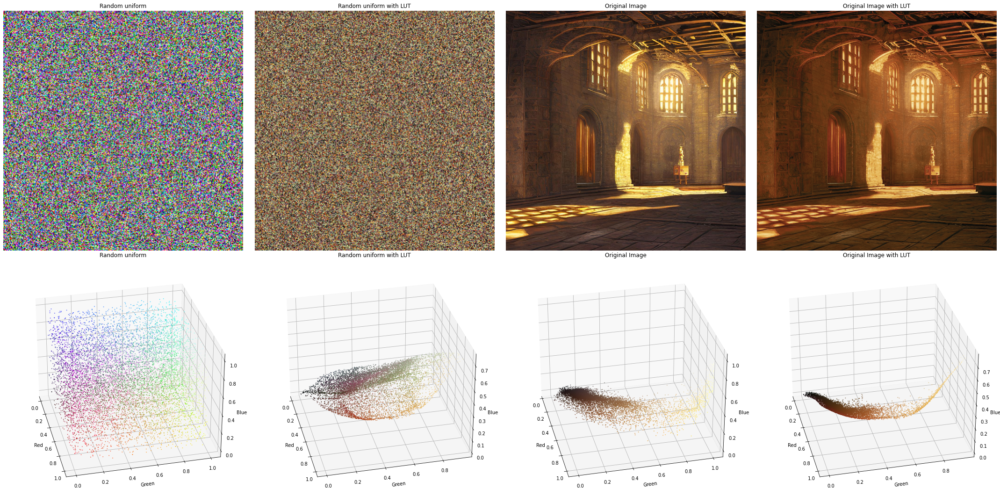

In [6]:
plot_lut()


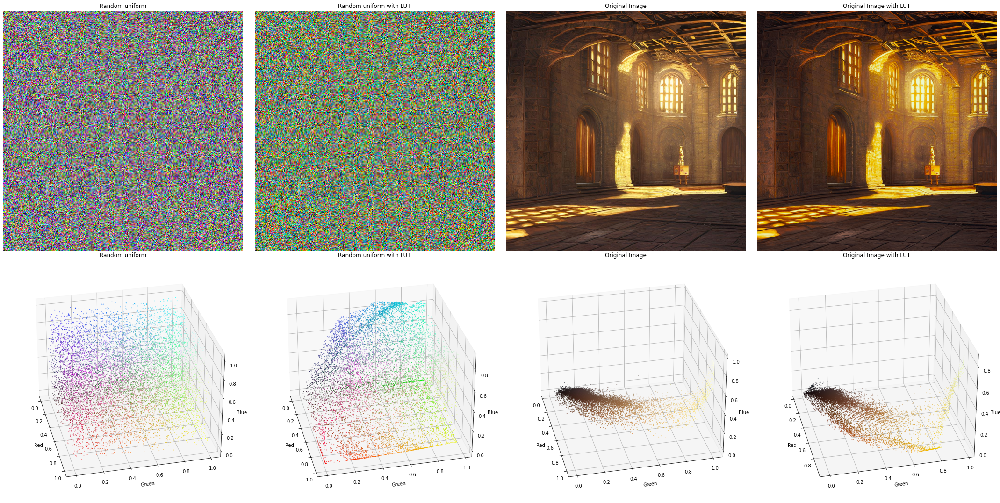

In [16]:
plot_lut(lut_path='Vision 4 - Rec.709.cube')


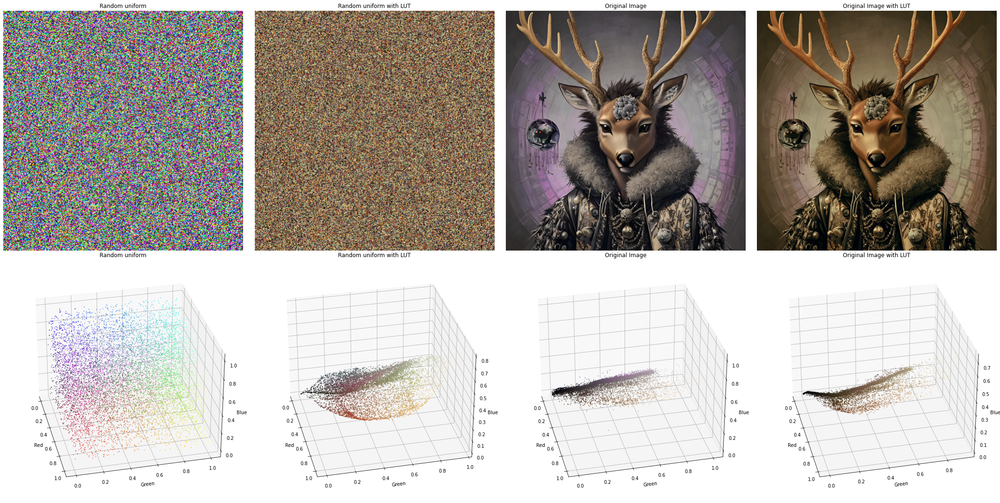

In [17]:
plot_lut(image_path='data/content (2).jpeg')


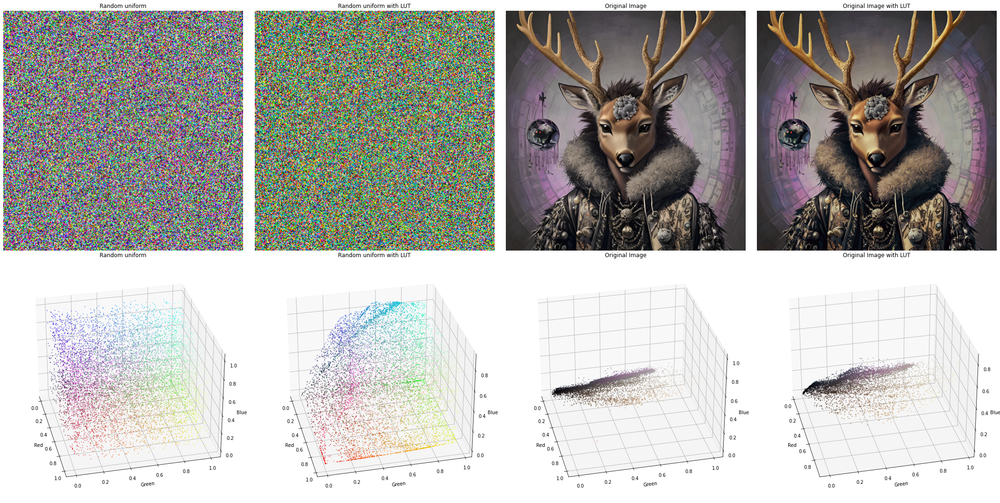

In [18]:
plot_lut(image_path='data/content (2).jpeg', lut_path='Vision 4 - Rec.709.cube')


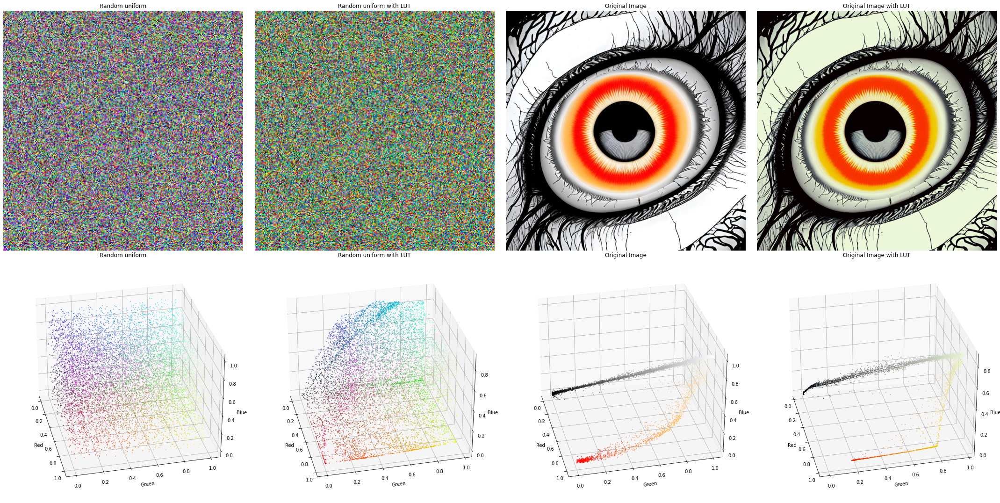

In [19]:
plot_lut(image_path='data/16805902646928945 (2).jpeg',lut_path='Vision 4 - Rec.709.cube')

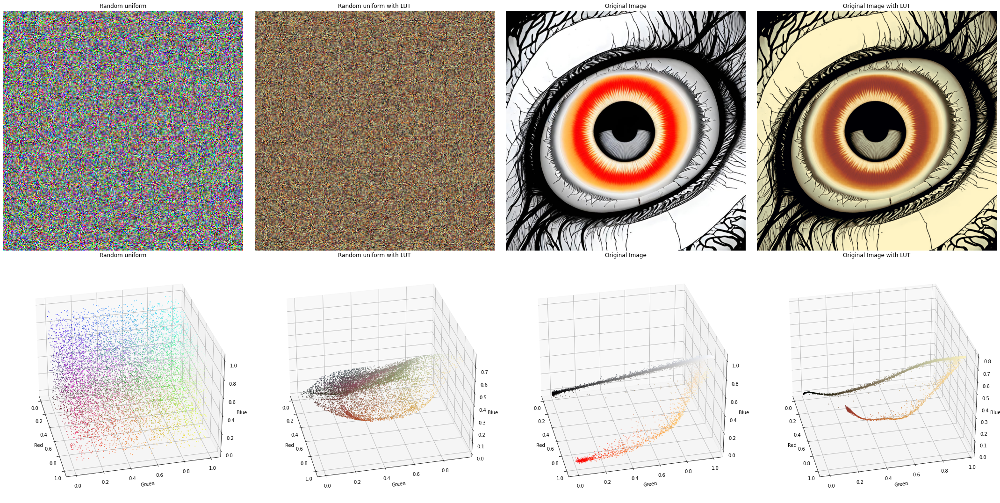

In [21]:
plot_lut(image_path='data/16805902646928945 (2).jpeg')